## Preprocessing notebook, remove bad points

In [1]:
import sys
import os

# Get the absolute path of parent folder
current_dir = os.path.abspath("")
parent_dir = os.path.join(current_dir, os.pardir)

# Add to sys.path
sys.path.append(parent_dir)

In [2]:
import ml_combat as ml
from ml_combat import data
from ml_combat.MetaModel import MetaModel

#### Imports

In [3]:
from prophet import Prophet
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import plotly.express as px
from statsmodels.tsa.seasonal import seasonal_decompose


In [4]:
df = ml.data.get_training_cleaned()

In [5]:
for location in df.location.unique():
    #df[df.location == location].set_index('time').temperature.plot(title=location + ' temperature')
    # plt.show()
    # df[df.location == location].set_index('time').consumption.plot(label=location, title='Consumption', figsize=(15,5))
    # plt.scatter(df[df.location==location]['ds'], df[df.location==location]['y'], label=location, s=2)#s=10, marker='o', color='blue')
    # plt.show()
    fig = px.scatter(df[(df.location == location) & (df.y != 0)], x='ds', y='y', title=f'Scatter Plot for {location}', labels={'ds': 'X-Axis Label', 'y': 'Y-Axis Label'})
    fig.update_traces(marker=dict(size=2), name=location)
    fig.show()


In [6]:
location = 'A'
temp_df = df[df.location == location]

In [7]:
fig = px.scatter(temp_df, x='ds', y='y', title=f'Scatter Plot for {location}', labels={'ds': 'X-Axis Label', 'y': 'Y-Axis Label'})
fig.update_traces(marker=dict(size=2), name=location)
fig.show()

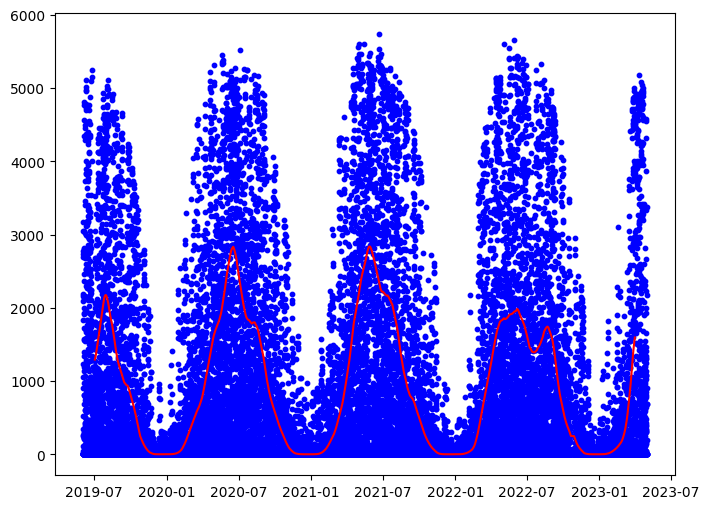

In [8]:
plt.figure(figsize=(8, 6))

window_size = 30*24  # Adjust the window size as needed
rolling_mean = temp_df['y'].rolling(window=window_size, center=True).quantile(0.75).rolling(24*30, center=True).mean()

plt.plot(temp_df['ds'], rolling_mean, label=f'Moving Average ({window_size}-day)', color='red')

plt.scatter(temp_df['ds'], temp_df['y'], s=10, marker='o', color='blue')
plt.show()

In [9]:
filtered_df = temp_df[temp_df.y < rolling_mean].copy()
# filtered_df['y_normalized'] = filtered_df['y'] / rolling_mean

# Create a scatter plot using Plotly Express
fig = px.scatter(filtered_df, x='ds', y='y', title=f'Scatter Plot for {location}', labels={'ds': 'X-Axis Label', 'y_normalized': 'Y-Axis Label'})

fig.show()


In [10]:
# df = ml.data.get_training_cleaned()

# # Filter the DataFrame by location
# location = 'A'
# filtered_df = df[df['location'] == location]

# # Set the period of seasonality (e.g., 12 for monthly data)
# period = 24

# # Initialize an empty DataFrame to store the seasonal components
# rolling_seasonal_components = pd.DataFrame()

# # Calculate the rolling seasonal decomposition
# window_size = 24*30  # Adjust the window size as needed
# for i in range(len(filtered_df) - window_size + 1):
#     window_data = filtered_df.iloc[i:i+window_size]
#     result = seasonal_decompose(window_data['y'], model='additive', period=period)
#     rolling_seasonal_components = pd.concat([rolling_seasonal_components, result.seasonal], axis=1)

# # Plot the rolling seasonal components
# rolling_seasonal_components.plot(legend=False, figsize=(10, 6))
# plt.title('Rolling Seasonal Components')
# plt.xlabel('Time')
# plt.ylabel('Seasonal Component')

# plt.show()

In [11]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
fig = px.scatter(temp_df, x='sun_azimuth:d', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [12]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
fig = px.scatter(temp_df, x='sun_elevation:d', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [14]:
temp_df['sun_azimuth_sin'] = np.sin(0.5*np.radians(temp_df['sun_azimuth:d']))


/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_1548/2984977686.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'

fig = px.scatter(temp_df, y='sun_azimuth_sin', x='ds', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [18]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
fig = px.scatter(temp_df, x='sun_azimuth_sin', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [19]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
fig = px.scatter(temp_df, x='sun_azimuth_sin', y='sun_elevation:d', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [22]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'

fig = px.scatter(temp_df, y='sun_elevation:d', x='ds', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [23]:
temp_df['angle_e'] = temp_df['sun_elevation:d'].max() - temp_df['sun_elevation:d'] 
temp_df['angle_a'] = 180 - temp_df['sun_azimuth:d']
temp_df['smallest_angle'] = 2*np.arcsin(
    np.sqrt(
        np.sin(np.radians(temp_df['angle_e']))**2 + np.sin(np.radians(temp_df['angle_a']))**2 
    ) / 2
)
temp_df['test_angle'] = np.arccos(np.cos(np.radians(temp_df['angle_a']))*np.cos(np.radians(temp_df['angle_e'])))

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_1548/1055368720.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_1548/1055368720.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_1548/1055368720.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [24]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'

fig = px.scatter(temp_df, x='test_angle', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [25]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'

fig = px.scatter(temp_df, x='smallest_angle', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [26]:
# px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'

fig = px.scatter(temp_df, x='smallest_angle', y='test_angle', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
fig.show()


In [4]:
from models_here_hahah.catboost_henrik import CatBoostHenrik

In [5]:

temp_df = ml.data.get_training_cleaned()

temp_df['angle_e'] = temp_df['sun_elevation:d'].max() - temp_df['sun_elevation:d'] 
temp_df['angle_a'] = 180 - temp_df['sun_azimuth:d']
temp_df['smallest_angle'] = 2*np.arcsin(
    np.sqrt(
        np.sin(np.radians(temp_df['angle_e']))**2 + np.sin(np.radians(temp_df['angle_a']))**2 
    ) / 2
)
temp_df['test_angle'] = np.arccos(np.cos(np.radians(temp_df['angle_a']))*np.cos(np.radians(temp_df['angle_e'])))

for location in ['A', 'B', 'C']:
    print("###########################################")
    print(f"###############  LOCATION {location} ###############")
    print("###########################################")
    df_location = temp_df[temp_df['location'] == location]

    cbh = CatBoostHenrik()
    cbh.test(df_location)

###########################################
###############  LOCATION A ###############
###########################################
Testing CatBoost Henrik
MAE Vals [354.57435282474233, 158.2268641684983, 223.79928090772168, 243.4644941096815, 137.0725449112296]
###########################################
###############  LOCATION B ###############
###########################################
Testing CatBoost Henrik
MAE Vals [22.681484202289337, 46.947925115490776, 43.36485030430791, 19.605526025351875, 26.928341144911222]
###########################################
###############  LOCATION C ###############
###########################################
Testing CatBoost Henrik
MAE Vals [99.88119884150446, 11.937932506996695, 47.44206038267958, 8.663005103640236, 25.36978396412852]


In [5]:
df = ml.data.get_training_cleaned()

lagged_dfs = []  # A list to store lagged DataFrames for each location

# Calculate the lag based on one year
one_year_lag = pd.DateOffset(years=1)

# Iterate over unique locations
for location in df['location'].unique():
    location_df = df[df['location'] == location]  # Filter by location
    
    # Create a one-year lagged feature for this location
    location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
    
    # Merge the lagged feature back to the original DataFrame
    lagged_location_df = location_df.merge(location_df[['ds', 'y']], left_on='ds_lagged_1yr', right_on='ds', how='left')
    lagged_location_df = lagged_location_df.rename(columns={'y_x': 'y', 'y_y': 'y_lagged_1yr', 'ds_x': 'ds'})
    lagged_location_df = lagged_location_df.drop(columns=['ds_y', 'ds_lagged_1yr'])
    
    lagged_dfs.append(lagged_location_df)

# Combine all the lagged DataFrames for different locations
result_df = pd.concat(lagged_dfs)


for location in ['A', 'B', 'C']:
    print("###########################################")
    print(f"###############  LOCATION {location} ###############")
    print("###########################################")
    df_location = result_df[result_df['location'] == location]

    cbh = CatBoostHenrik()
    cbh.test(df_location)

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2753/4189025563.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2753/4189025563.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2753/4189025563.py:13: SettingWithCopyWarning: 
A value is trying to 

###########################################
###############  LOCATION A ###############
###########################################
Testing CatBoost Henrik
MAE Vals [382.68758698171996, 162.04701275672255, 220.10318982528315, 242.38949285728665, 132.50116232748303]
###########################################
###############  LOCATION B ###############
###########################################
Testing CatBoost Henrik
MAE Vals [20.952753068757428, 46.45888084154707, 44.3252222395896, 20.0399394883394, 27.70056446234316]
###########################################
###############  LOCATION C ###############
###########################################
Testing CatBoost Henrik
MAE Vals [86.68605263742216, 11.271490607332767, 50.79873970726598, 8.56940522196228, 24.204899971471963]


In [5]:
from models_here_hahah.lightgbm_henrik import LightBGMHenrik

In [5]:
df = ml.data.get_training_cleaned()

lagged_dfs = []  # A list to store lagged DataFrames for each location

# Calculate the lag based on one year
one_year_lag = pd.DateOffset(years=1)

# Iterate over unique locations
for location in df['location'].unique():
    location_df = df[df['location'] == location]  # Filter by location
    
    # Create a one-year lagged feature for this location
    location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
    
    # Merge the lagged feature back to the original DataFrame
    lagged_location_df = location_df.merge(location_df[['ds', 'y']], left_on='ds_lagged_1yr', right_on='ds', how='left')
    lagged_location_df = lagged_location_df.rename(columns={'y_x': 'y', 'y_y': 'y_lagged_1yr', 'ds_x': 'ds'})
    lagged_location_df = lagged_location_df.drop(columns=['ds_y', 'ds_lagged_1yr'])
    
    lagged_dfs.append(lagged_location_df)

# Combine all the lagged DataFrames for different locations
result_df = pd.concat(lagged_dfs)


for location in ['A', 'B', 'C']:
    print("###########################################")
    print(f"###############  LOCATION {location} ###############")
    print("###########################################")
    df_location = result_df[result_df['location'] == location]

    cbh = LightBGMHenrik()
    cbh.test(df_location)

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2859/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2859/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2859/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to 

###########################################
###############  LOCATION A ###############
###########################################
Testing LightBGM Henrik
MAE Vals [309.65732960214046, 148.30777616302333, 205.2069292401207, 232.3361818416927, 125.9815507281751]
###########################################
###############  LOCATION B ###############
###########################################
Testing LightBGM Henrik
MAE Vals [17.699078860783917, 41.76714152192434, 43.08849428980107, 19.0386547396093, 27.77302293997872]
###########################################
###############  LOCATION C ###############
###########################################
Testing LightBGM Henrik
MAE Vals [93.4955568679725, 9.347766640635863, 46.26288547720507, 7.420395268788765, 23.282277886046355]


In [6]:
df = ml.data.get_training_cleaned()

lagged_dfs = []  # A list to store lagged DataFrames for each location

# Calculate the lag based on one year
one_year_lag = pd.DateOffset(years=1)

# Iterate over unique locations
for location in df['location'].unique():
    location_df = df[df['location'] == location]  # Filter by location
    
    # Create a one-year lagged feature for this location
    location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
    
    # Merge the lagged feature back to the original DataFrame
    lagged_location_df = location_df.merge(location_df[['ds', 'y']], left_on='ds_lagged_1yr', right_on='ds', how='left')
    lagged_location_df = lagged_location_df.rename(columns={'y_x': 'y', 'y_y': 'y_lagged_1yr', 'ds_x': 'ds'})
    lagged_location_df = lagged_location_df.drop(columns=['ds_y', 'ds_lagged_1yr'])
    
    lagged_dfs.append(lagged_location_df)

# Combine all the lagged DataFrames for different locations
result_df = pd.concat(lagged_dfs)


for location in ['A', 'B', 'C']:
    print("###########################################")
    print(f"###############  LOCATION {location} ###############")
    print("###########################################")
    df_location = result_df[result_df['location'] == location]

    cbh = LightBGMHenrik()
    cbh.test(df_location)

/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2883/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2883/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  location_df['ds_lagged_1yr'] = location_df['ds'] - one_year_lag
/var/folders/rn/zrxftcb56xg254wsfbhrtbt80000gn/T/ipykernel_2883/2616132339.py:13: SettingWithCopyWarning: 
A value is trying to 

###########################################
###############  LOCATION A ###############
###########################################
Testing LightBGM Henrik
MAE Vals [309.65732960214046, 146.4027889124817, 206.97486059176737, 232.92277550113388, 123.61086735506251]
###########################################
###############  LOCATION B ###############
###########################################
Testing LightBGM Henrik
MAE Vals [17.699078860783917, 41.75348446910229, 41.900997510551065, 18.96487453157874, 27.503697206349987]
###########################################
###############  LOCATION C ###############
###########################################
Testing LightBGM Henrik
MAE Vals [93.4955568679725, 9.347766640635863, 44.87335305294225, 7.355206914221951, 23.417235816714996]


In [6]:
df = ml.data.get_training_cleaned()


In [7]:
df

,location,ds,y,weather_data_type,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,A,2019-06-02 22:00:00,0.00,observed,7.700,1.22825,1728.950012,0.000000,0.000,1728.950012,...,348.036758,-3.77425,0.000,286.224998,100.000000,40386.475586,3.600,-3.575,-0.500,0.0
1,A,2019-06-02 23:00:00,0.00,observed,7.700,1.22350,1689.824982,0.000000,0.000,1689.824982,...,91.980751,-4.35725,0.000,286.899994,100.000000,33770.649414,3.350,-3.350,0.275,0.0
2,A,2019-06-03 00:00:00,0.00,observed,7.875,1.21975,1563.225006,0.000000,0.000,1563.225006,...,14.934750,-3.30950,0.000,286.949997,100.000000,13595.500000,3.050,-2.950,0.750,0.0
3,A,2019-06-03 01:00:00,0.00,observed,8.425,1.21800,1283.425018,208.649994,0.750,1283.425018,...,28.630250,-0.82250,0.000,286.750000,100.000000,2321.850037,2.725,-2.600,0.875,0.0
4,A,2019-06-03 02:00:00,19.36,observed,8.950,1.21800,1003.500000,32468.150269,23.100,1003.500000,...,41.997500,3.05125,0.000,286.449997,99.225000,11634.799683,2.550,-2.350,0.925,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101358,C,2023-04-30 19:00:00,50.96,estimated,4.400,1.27550,1456.574982,84010.151367,4.175,551.224991,...,304.936501,-0.20150,0.000,274.925003,97.725000,25027.999512,4.075,3.600,1.875,0.0
101359,C,2023-04-30 20:00:00,2.94,estimated,4.400,1.27850,1476.350006,2206.800018,0.000,564.099991,...,318.620499,-5.20400,0.000,274.575005,95.850002,23995.599609,3.600,2.950,2.125,0.0
101360,C,2023-04-30 21:00:00,0.00,estimated,4.400,1.27900,1516.299988,0.000000,0.000,578.699997,...,332.780251,-8.98450,0.025,274.399994,95.925001,23068.600098,3.600,2.625,2.400,0.0
101361,C,2023-04-30 22:00:00,0.00,estimated,4.400,1.27975,1240.600006,0.000000,0.000,551.500000,...,347.373245,-11.27050,0.125,274.225006,99.425001,11856.700195,3.275,2.325,2.325,0.0


In [13]:
for location in df.location.unique():
    #df[df.location == location].set_index('time').temperature.plot(title=location + ' temperature')
    # plt.show()
    # df[df.location == location].set_index('time').consumption.plot(label=location, title='Consumption', figsize=(15,5))
    # plt.scatter(df[df.location==location]['ds'], df[df.location==location]['y'], label=location, s=2)#s=10, marker='o', color='blue')
    # plt.show()
    fig = px.scatter(df[(df.location == location)], x='sun_elevation:d', y='y', title=f'Scatter Plot for {location}', labels={'ds': 'X-Axis Label', 'y': 'Y-Axis Label'})
    fig.update_traces(marker=dict(size=2), name=location)
    fig.show()

# # px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
#     fig = px.scatter(df, x='sun_elevation:d', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
#     fig.show()


In [12]:
for location in df.location.unique():
    #df[df.location == location].set_index('time').temperature.plot(title=location + ' temperature')
    # plt.show()
    # df[df.location == location].set_index('time').consumption.plot(label=location, title='Consumption', figsize=(15,5))
    # plt.scatter(df[df.location==location]['ds'], df[df.location==location]['y'], label=location, s=2)#s=10, marker='o', color='blue')
    # plt.show()
    fig = px.scatter(df[(df.location == location)], y='sun_elevation:d', x='ds', title=f'Scatter Plot for {location}', labels={'ds': 'X-Axis Label', 'y': 'Y-Axis Label'})
    fig.update_traces(marker=dict(size=2), name=location)
    fig.show()

# # px.scatter(temp_df['sun_azimuth:d'], temp_df.y)# 'sun_elevation:d'
#     fig = px.scatter(df, x='sun_elevation:d', y='y', title='Scatter Plot', labels={'sun_azimuth:d': 'Sun Azimuth', 'y': 'Y-Axis Label'})
#     fig.show()


In [18]:
df[(df.location == 'B') & (df['sun_elevation:d'] < -4) & (df.y != 0)]

,location,ds,y,weather_data_type,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
34799,B,2019-01-30 16:00:00,6.900000,observed,2.400,1.28375,1061.075012,0.000000,0.0,1061.075012,...,247.062252,-8.596250,0.000,272.474998,99.850002,57705.424805,2.075,-1.450,1.450,0.0
36145,B,2019-03-27 18:00:00,1.725000,observed,5.500,1.26850,178.150003,16314.325317,0.0,178.150003,...,284.535751,-4.468500,0.100,279.000000,70.675001,39280.725586,3.400,0.250,3.400,0.0
36169,B,2019-03-28 18:00:00,15.525000,observed,4.325,1.23625,1139.625000,18808.124512,0.0,1139.625000,...,284.773491,-4.148000,0.000,284.550003,35.500000,53677.699219,5.200,3.475,3.850,0.0
41356,B,2019-10-30 21:00:00,18.975000,observed,6.300,1.27100,588.875015,0.000000,0.0,588.875015,...,329.692993,-37.255001,0.000,276.725006,100.000000,1330.099976,5.200,4.725,2.275,0.0
41357,B,2019-10-30 22:00:00,18.975000,observed,6.275,1.27100,656.699997,0.000000,0.0,656.699997,...,348.127502,-39.663999,0.050,276.774994,100.000000,1119.500000,5.300,5.050,1.500,0.0
44931,B,2020-03-27 20:00:00,118.162500,observed,5.750,1.28000,1243.250015,0.000000,0.0,351.424995,...,313.145996,-15.965750,0.375,275.500000,98.874998,4750.575043,5.250,4.975,1.675,0.0
44932,B,2020-03-27 21:00:00,118.162500,observed,5.325,1.28000,1900.999969,0.000000,0.0,513.650002,...,328.317253,-20.205000,0.150,275.799995,85.100000,19573.875000,5.450,5.200,1.600,0.0
44953,B,2020-03-28 18:00:00,8.625000,observed,3.600,1.32275,2512.400024,20467.475391,0.0,503.300011,...,285.169006,-4.008000,0.000,269.399994,75.299999,32437.625000,5.050,4.750,-1.700,0.0
48555,B,2020-08-25 20:00:00,183.712500,observed,8.675,1.22800,1320.350006,0.000000,0.0,923.675003,...,316.568001,-8.667750,0.500,283.449997,100.000000,3888.674988,3.900,3.125,2.375,0.0
48556,B,2020-08-25 21:00:00,183.712500,observed,8.500,1.22800,1351.425018,0.000000,0.0,912.899994,...,331.059761,-12.622500,0.400,283.324989,99.950001,4750.625000,3.850,2.900,2.525,0.0
